In [1]:
import matplotlib.pyplot as plt
import libmambapy

import mamba_error_reporting as mer


def solve_with_error(pb_factory):
    solver, pool = pb_factory()
    success = solver.try_solve()
    if success:
        raise RuntimeError(f"{pb_factory.__name__} was solved successfully")
    pbs = libmambapy.ProblemsGraph.from_solver(solver, pool)
    cp_pbs = libmambapy.CompressedProblemsGraph.from_problems_graph(pbs)
    return solver, pbs, cp_pbs


def print_graphs(pbs, cp_pbs, name):
    print("{:=^110}".format(" Original graph "))
    fig, ax = mer.plot.plot_libmamba_solvable_dag(pbs)
    fig.savefig(f"{name}_solvables.svg")
    plt.show()
    print("{:=^110}".format(" Compressed graph "))
    fig, ax = mer.plot.plot_libmamba_compressed_dag(cp_pbs)
    fig.savefig(f"{name}_compressed.svg")
    plt.show()
    
def print_messages(cp_pbs):
    print("{:=^110}".format(" Libmamba error message "))
    print(cp_pbs.tree_message())


def detail_problem(pb_factory):
    solver, pbs, cp_pbs = solve_with_error(pb_factory)
    print_graphs(pbs, cp_pbs, name=pb_factory.__name__.removeprefix("create_"))
    print_messages(cp_pbs)

# Basic Conflict

=============================================== Original graph ===============================================


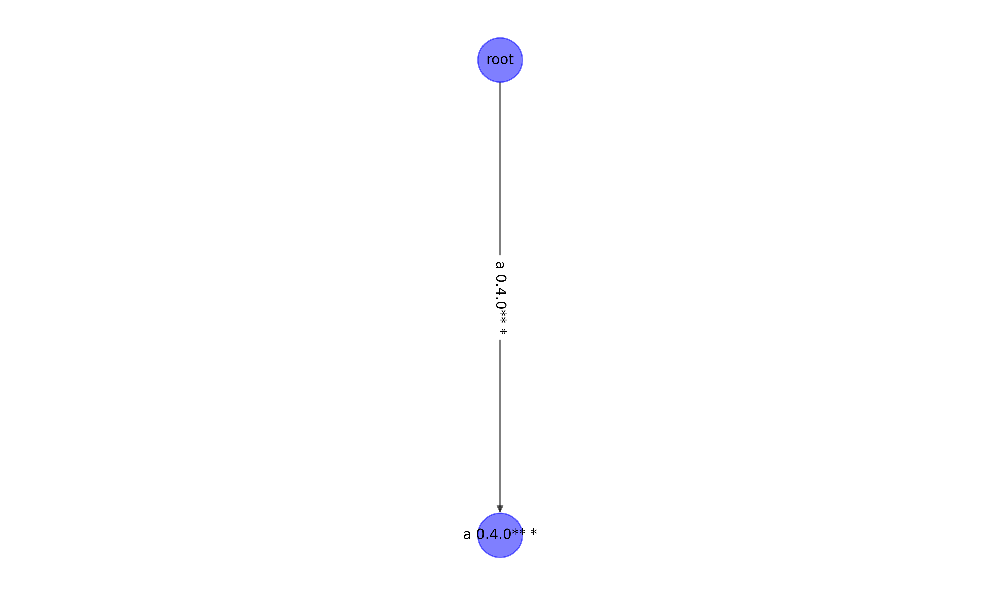

<Figure size 3000x1800 with 0 Axes>

============================================== Compressed graph ==============================================


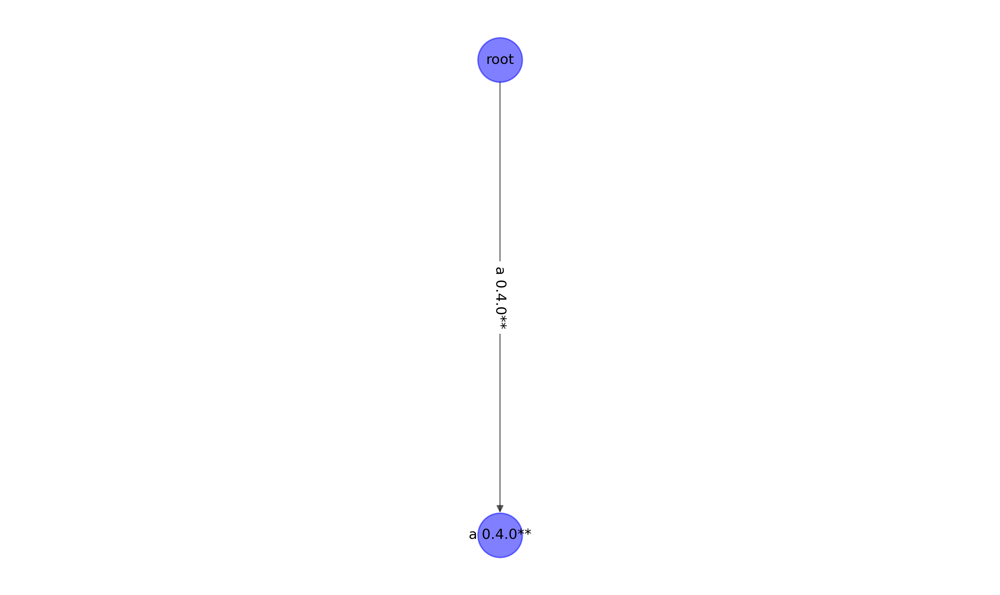

<Figure size 3000x1800 with 0 Axes>

=========================================== Libmamba error message ===========================================
The following package could not be installed
└─ a 0.4.0** * does not exsist (perhaps a typo or a missing channel).


In [2]:
detail_problem(mer.problems.create_basic_conflict)

# PubGrub

=============================================== Original graph ===============================================


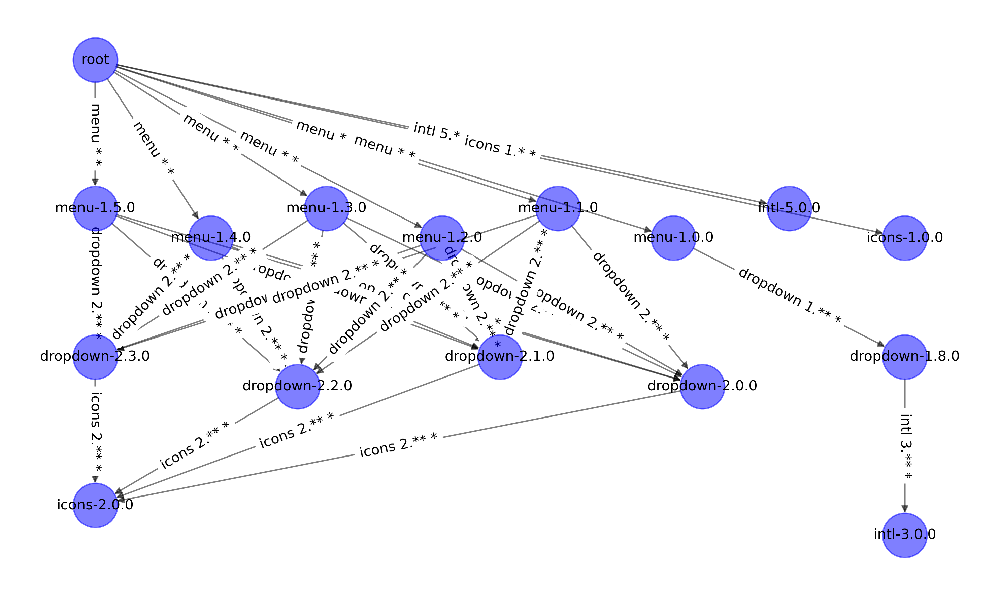

<Figure size 3000x1800 with 0 Axes>

============================================== Compressed graph ==============================================


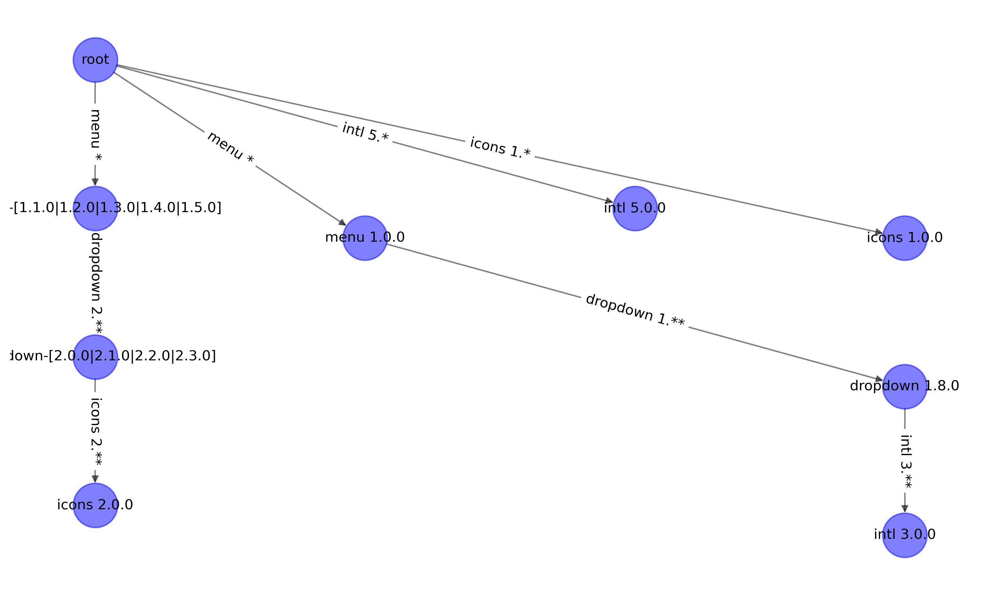

<Figure size 3000x1800 with 0 Axes>

=========================================== Libmamba error message ===========================================
The following packages are incompatible
├─ icons 1.* * is requested and can be installed;
├─ intl 5.* * is requested and can be installed;
└─ menu * * is uninstallable because there are no viable options
   ├─ menu [1.1.0|1.2.0|1.3.0|1.4.0|1.5.0] would require
   │  └─ dropdown 2.** *, which requires
   │     └─ icons 2.** *, which conflicts with any installable versions previously reported;
   └─ menu 1.0.0 would require
      └─ dropdown 1.** *, which requires
         └─ intl 3.** *, which conflicts with any installable versions previously reported.


In [3]:
detail_problem(mer.problems.create_pubgrub)

# PubGrub Hard

=============================================== Original graph ===============================================


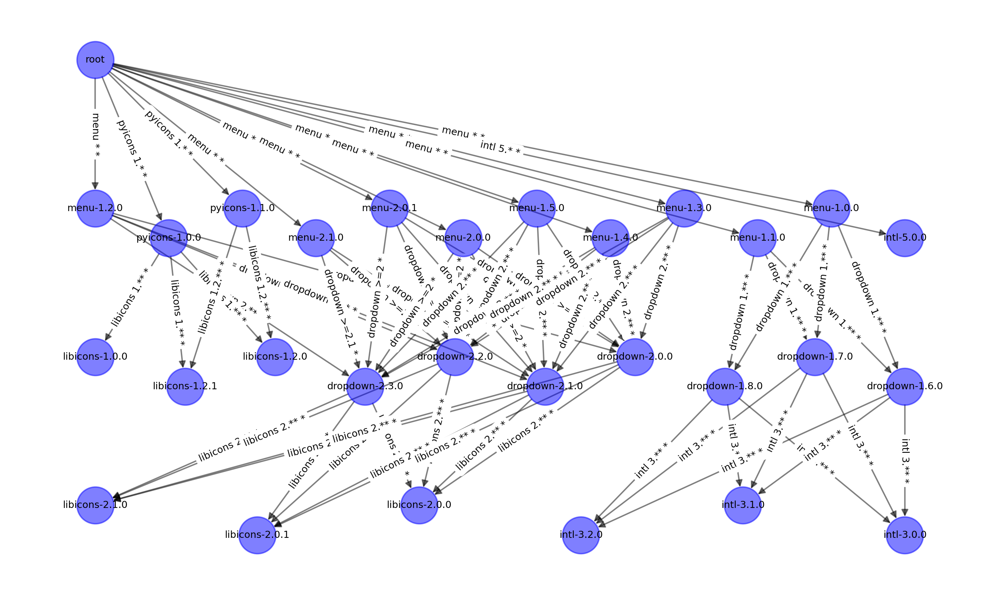

<Figure size 3000x1800 with 0 Axes>

============================================== Compressed graph ==============================================


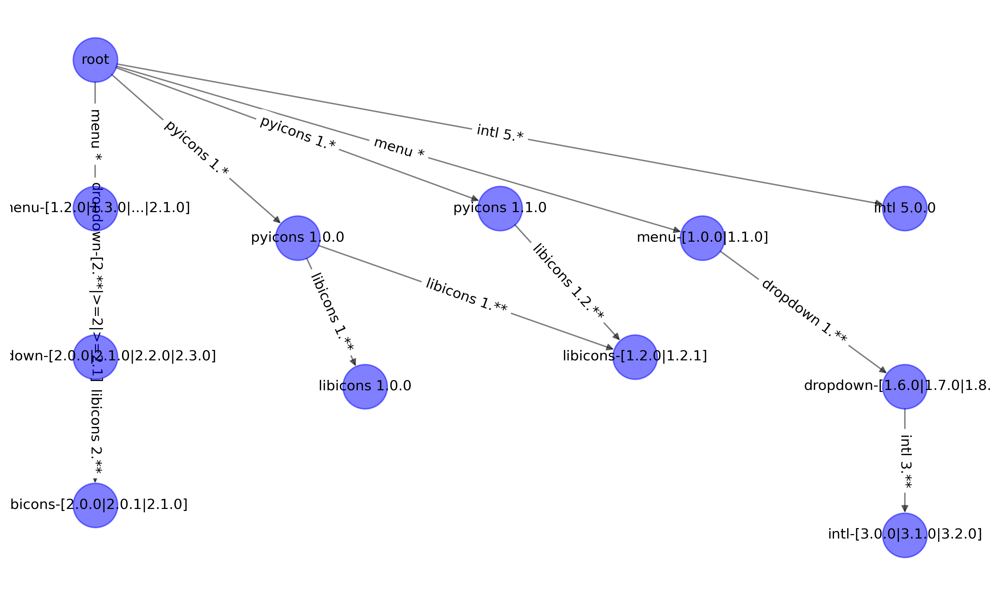

<Figure size 3000x1800 with 0 Axes>

=========================================== Libmamba error message ===========================================
The following packages are incompatible
├─ intl 5.* * is requested and can be installed;
├─ menu * * is installable with the potential options
│  ├─ menu [1.2.0|1.3.0|...|2.1.0] would require
│  │  └─ dropdown [2.**|>=2|>=2.1] [*|*|*], which requires
│  │     └─ libicons 2.** *, which can be installed;
│  └─ menu [1.0.0|1.1.0] would require
│     └─ dropdown 1.** *, which requires
│        └─ intl 3.** *, which conflicts with any installable versions previously reported;
└─ pyicons 1.* * is uninstallable because there are no viable options
   ├─ pyicons 1.0.0 would require
   │  └─ libicons 1.** *, which conflicts with any installable versions previously reported;
   └─ pyicons 1.1.0 would require
      └─ libicons 1.2.** *, which conflicts with any installable versions previously reported.


In [4]:
detail_problem(mer.problems.create_pubgrub_hard)

# PubGrub Missing

=============================================== Original graph ===============================================


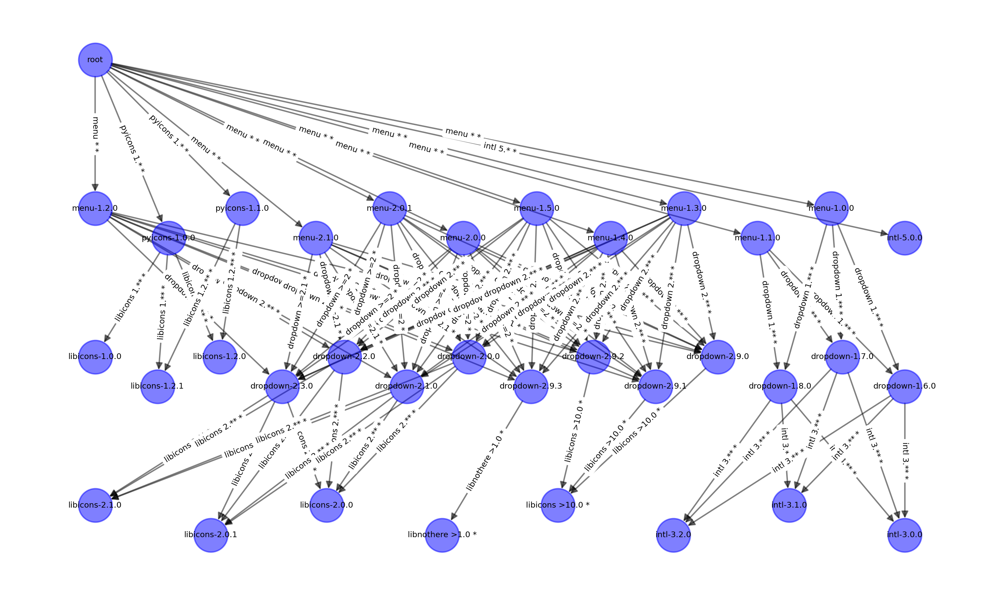

<Figure size 3000x1800 with 0 Axes>

============================================== Compressed graph ==============================================


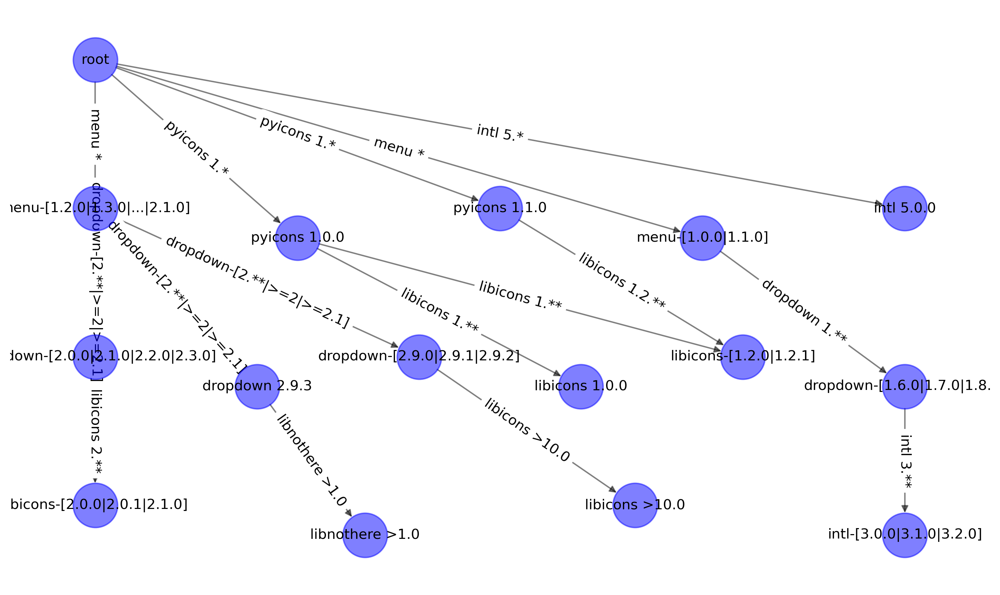

<Figure size 3000x1800 with 0 Axes>

=========================================== Libmamba error message ===========================================
The following packages are incompatible
├─ intl 5.* * is requested and can be installed;
├─ menu * * is installable with the potential options
│  ├─ menu [1.2.0|1.3.0|...|2.1.0] would require
│  │  └─ dropdown [2.**|>=2|>=2.1] [*|*|*] with the potential options
│  │     ├─ dropdown [2.0.0|2.1.0|2.2.0|2.3.0] would require
│  │     │  └─ libicons 2.** *, which can be installed;
│  │     ├─ dropdown 2.9.3 would require
│  │     │  └─ libnothere >1.0 *, which does not exsist (perhaps a missing channel);
│  │     └─ dropdown [2.9.0|2.9.1|2.9.2] would require
│  │        └─ libicons >10.0 *, which does not exsist (perhaps a missing channel);
│  └─ menu [1.0.0|1.1.0] would require
│     └─ dropdown 1.** *, which requires
│        └─ intl 3.** *, which conflicts with any installable versions previously reported;
└─ pyicons 1.* * is uninstallable because there are no viable options
   

In [5]:
detail_problem(mer.problems.create_pubgrub_missing)

# R Base

=============================================== Original graph ===============================================


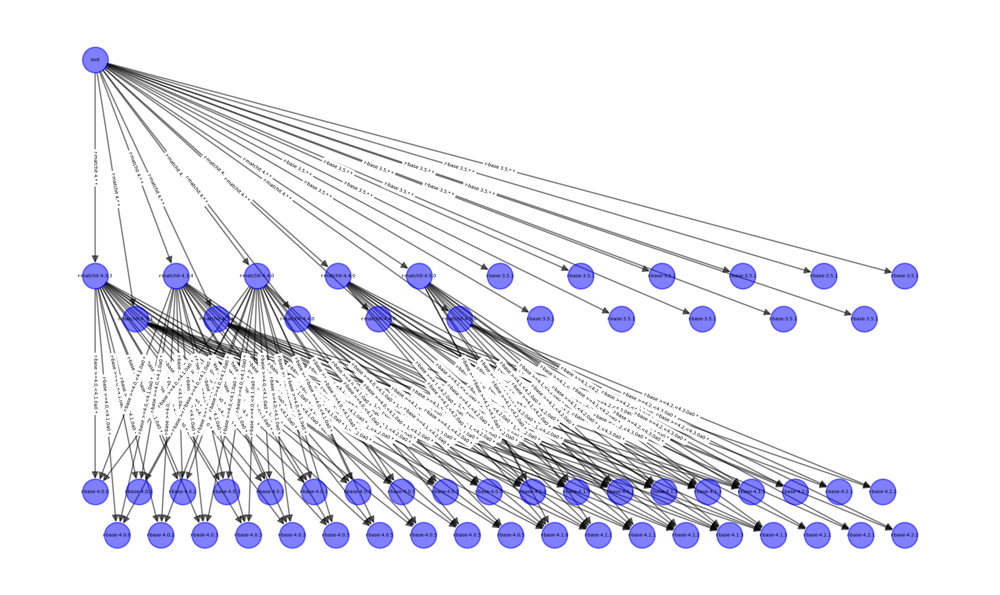

<Figure size 3000x1800 with 0 Axes>

============================================== Compressed graph ==============================================


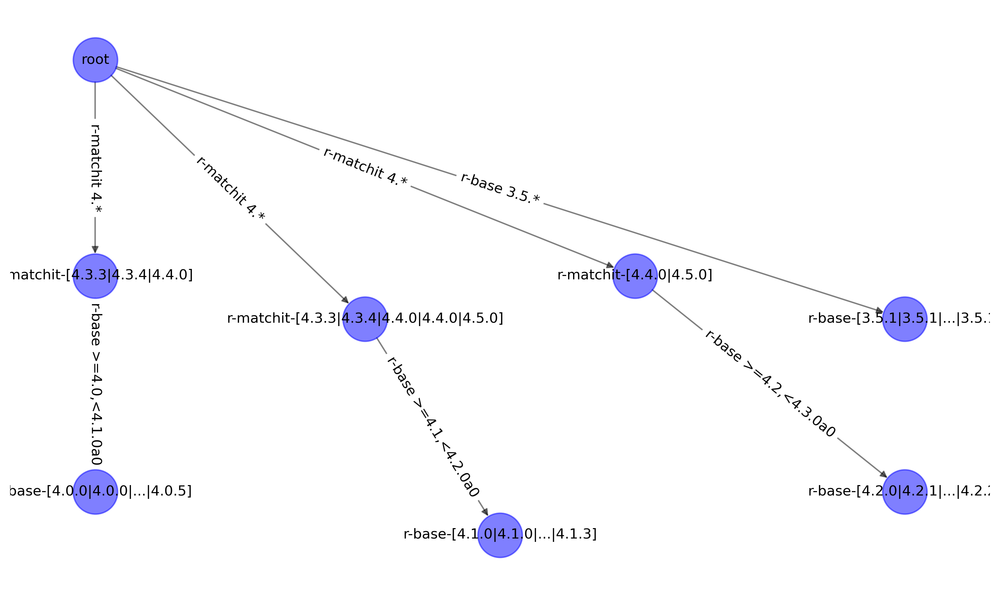

<Figure size 3000x1800 with 0 Axes>

=========================================== Libmamba error message ===========================================
The following packages are incompatible
├─ r-base 3.5.* * is requested and can be installed;
└─ r-matchit 4.* * is uninstallable because there are no viable options
   ├─ r-matchit [4.3.3|4.3.4|4.4.0] would require
   │  └─ r-base >=4.0,<4.1.0a0 *, which conflicts with any installable versions previously reported;
   ├─ r-matchit [4.3.3|4.3.4|4.4.0|4.4.0|4.5.0] would require
   │  └─ r-base >=4.1,<4.2.0a0 *, which conflicts with any installable versions previously reported;
   └─ r-matchit [4.4.0|4.5.0] would require
      └─ r-base >=4.2,<4.3.0a0 *, which conflicts with any installable versions previously reported.


In [6]:
detail_problem(mer.problems.create_r_base)

# Pytorch CPU

conda-forge/linux-64                                        Using cache
conda-forge/noarch                                          Using cache
=============================================== Original graph ===============================================


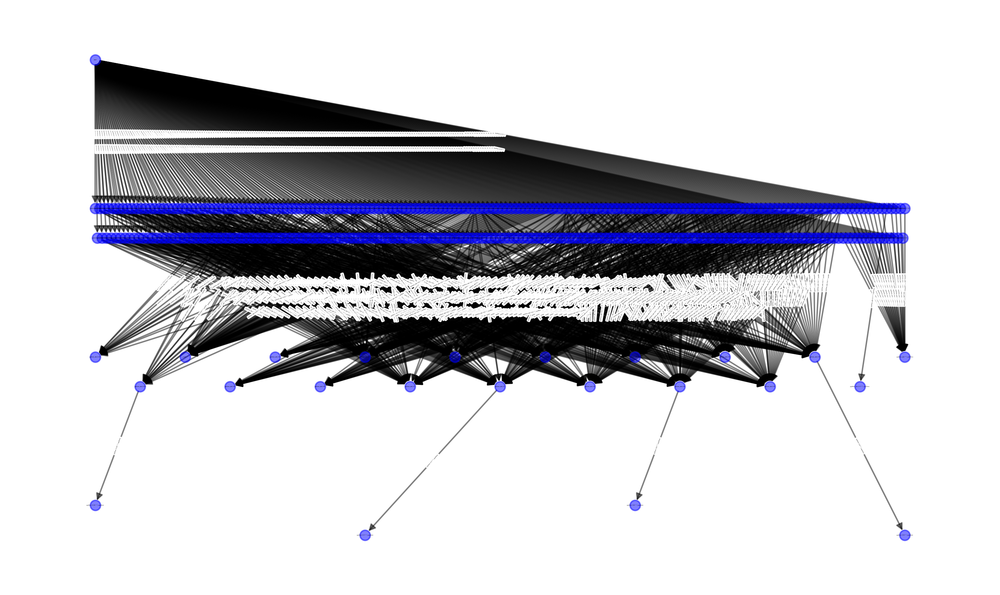

<Figure size 3000x1800 with 0 Axes>

============================================== Compressed graph ==============================================


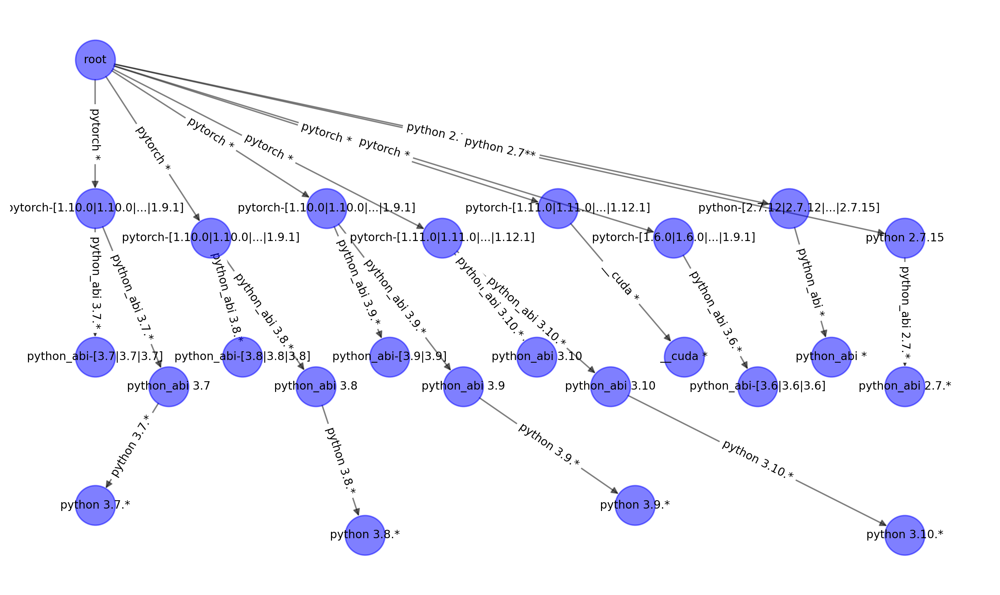

<Figure size 3000x1800 with 0 Axes>

=========================================== Libmamba error message ===========================================
The following packages are incompatible
├─ python 2.7** * is installable with the potential options
│  ├─ python [2.7.12|2.7.12|...|2.7.15] would require
│  │  └─ python_abi * *_cp27mu, which can be installed;
│  └─ python 2.7.15 would require
│     └─ python_abi 2.7.* *_cp27mu, which can be installed;
└─ pytorch * * is installable with the potential options
   ├─ pytorch [1.10.0|1.10.0|...|1.9.1] would require
   │  └─ python_abi 3.7.* *_cp37m with the potential options
   │     ├─ python_abi [3.7|3.7|3.7] conflicts with any installable versions previously reported;
   │     └─ python_abi 3.7 would require
   │        └─ python 3.7.* *_cpython, which can be installed;
   ├─ pytorch [1.10.0|1.10.0|...|1.9.1] would require
   │  └─ python_abi 3.8.* *_cp38 with the potential options
   │     ├─ python_abi [3.8|3.8|3.8] conflicts with any installable versions previously reported;

In [7]:
detail_problem(mer.problems.create_pytorch_cpu)

# Pytorch Cuda

conda-forge/linux-64                                        Using cache
conda-forge/noarch                                          Using cache
=============================================== Original graph ===============================================


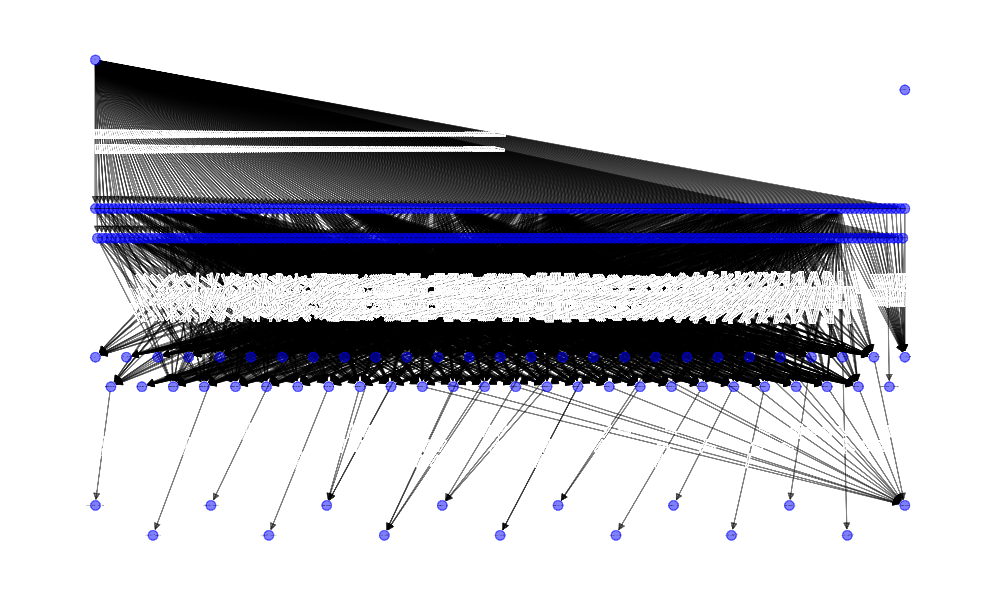

<Figure size 3000x1800 with 0 Axes>

============================================== Compressed graph ==============================================


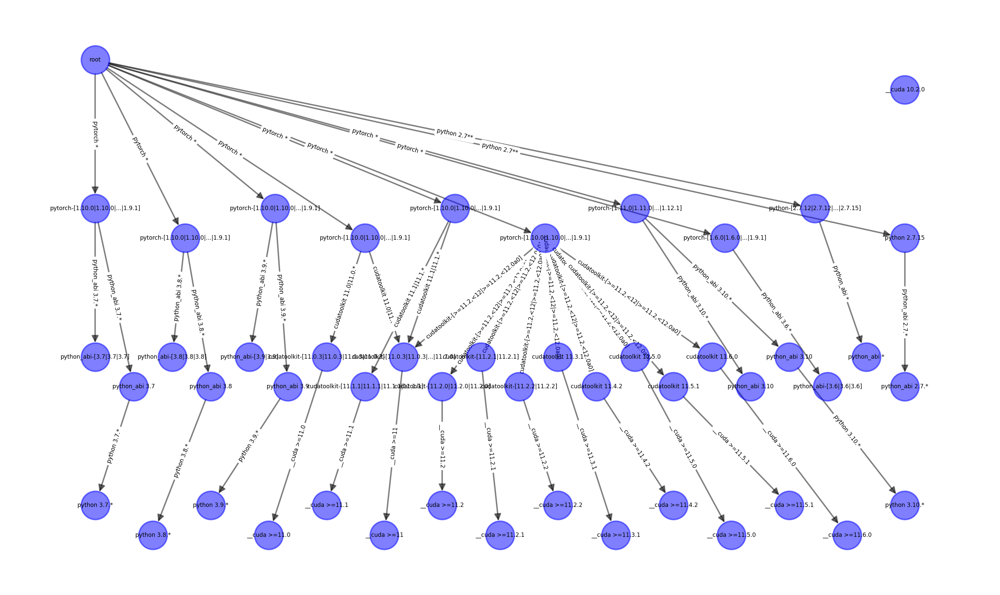

<Figure size 3000x1800 with 0 Axes>

=========================================== Libmamba error message ===========================================
The following packages are incompatible
├─ python 2.7** * is installable with the potential options
│  ├─ python [2.7.12|2.7.12|...|2.7.15] would require
│  │  └─ python_abi * *_cp27mu, which can be installed;
│  └─ python 2.7.15 would require
│     └─ python_abi 2.7.* *_cp27mu, which can be installed;
└─ pytorch * * is installable with the potential options
   ├─ pytorch [1.10.0|1.10.0|...|1.9.1] would require
   │  └─ python_abi 3.7.* *_cp37m with the potential options
   │     ├─ python_abi [3.7|3.7|3.7] conflicts with any installable versions previously reported;
   │     └─ python_abi 3.7 would require
   │        └─ python 3.7.* *_cpython, which can be installed;
   ├─ pytorch [1.10.0|1.10.0|...|1.9.1] would require
   │  └─ python_abi 3.8.* *_cp38 with the potential options
   │     ├─ python_abi [3.8|3.8|3.8] conflicts with any installable versions previously reported;

In [8]:
detail_problem(mer.problems.create_pytorch_cuda)

## CudaToolkit

conda-forge/linux-64                                        Using cache
conda-forge/noarch                                          Using cache
=============================================== Original graph ===============================================


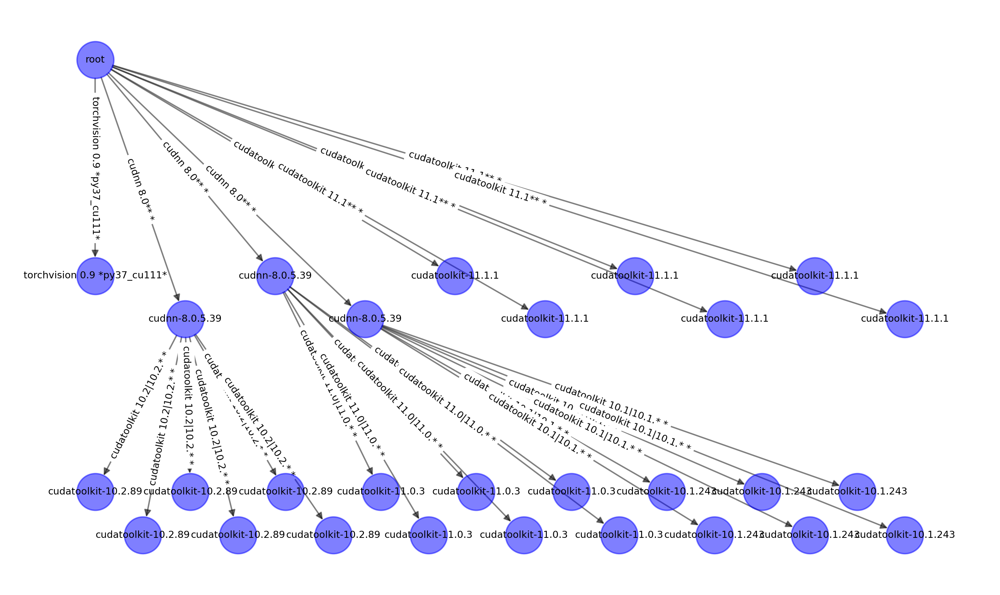

<Figure size 3000x1800 with 0 Axes>

============================================== Compressed graph ==============================================


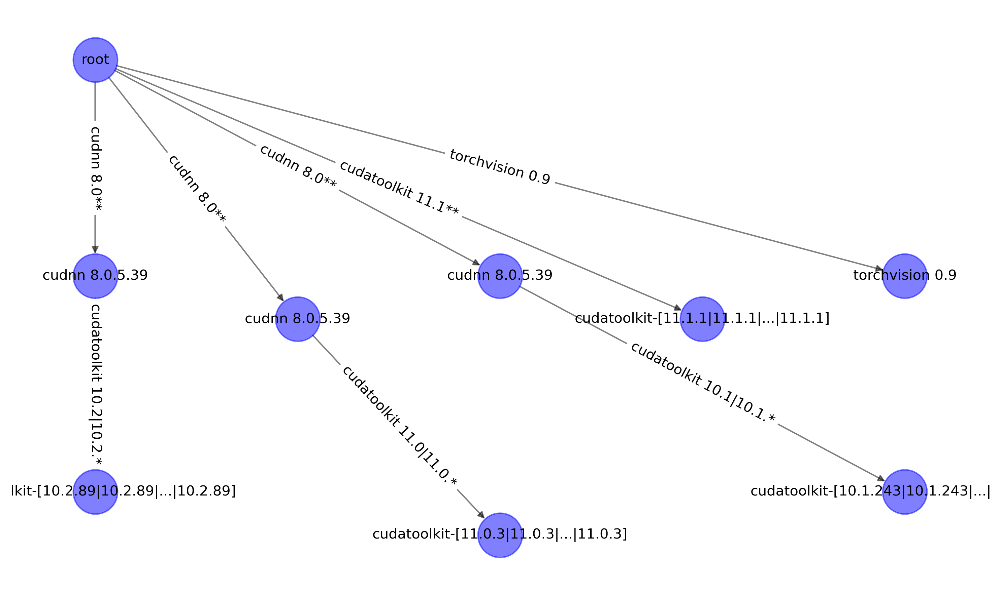

<Figure size 3000x1800 with 0 Axes>

=========================================== Libmamba error message ===========================================
The following packages are incompatible
├─ cudatoolkit 11.1** * is requested and can be installed;
├─ cudnn 8.0** * is uninstallable because there are no viable options
│  ├─ cudnn 8.0.5.39 would require
│  │  └─ cudatoolkit 10.2|10.2.* *, which conflicts with any installable versions previously reported;
│  ├─ cudnn 8.0.5.39 would require
│  │  └─ cudatoolkit 11.0|11.0.* *, which conflicts with any installable versions previously reported;
│  └─ cudnn 8.0.5.39 would require
│     └─ cudatoolkit 10.1|10.1.* *, which conflicts with any installable versions previously reported;
└─ torchvision 0.9 *py37_cu111* does not exsist (perhaps a typo or a missing channel).


In [9]:
detail_problem(mer.problems.create_cudatoolkit)

## Jpeg9b

conda-forge/linux-64                                        Using cache
conda-forge/noarch                                          Using cache
=============================================== Original graph ===============================================


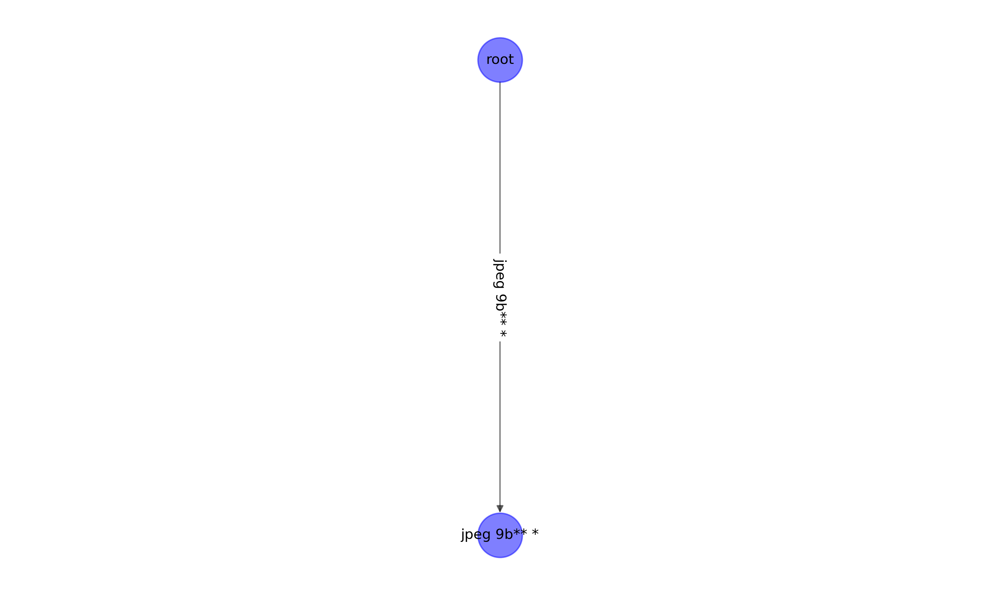

<Figure size 3000x1800 with 0 Axes>

============================================== Compressed graph ==============================================


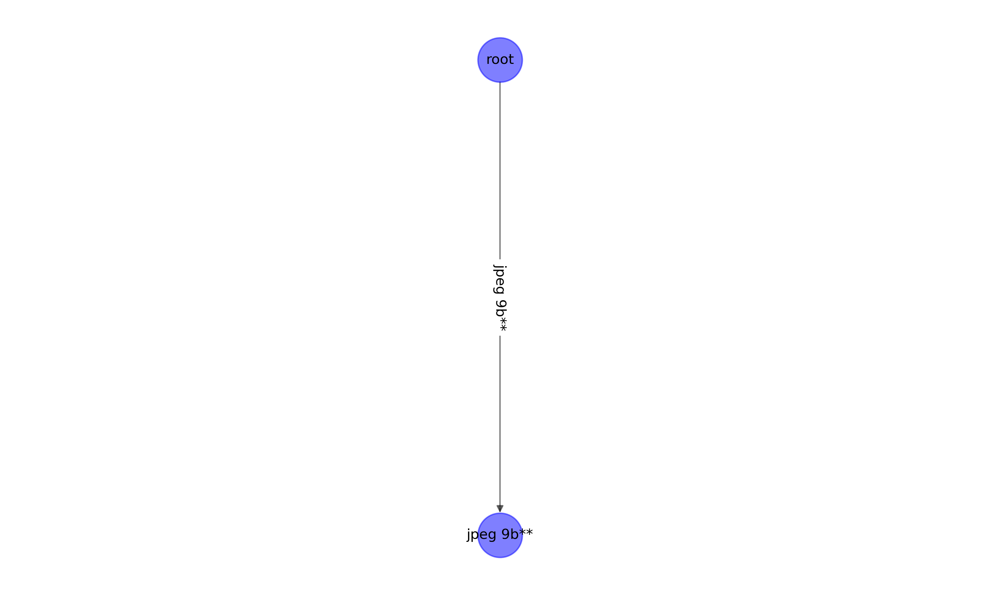

<Figure size 3000x1800 with 0 Axes>

=========================================== Libmamba error message ===========================================
The following package could not be installed
└─ jpeg 9b** * does not exsist (perhaps a typo or a missing channel).


In [10]:
detail_problem(mer.problems.create_jpeg9b)

# SCIP

conda-forge/linux-64                                        Using cache
conda-forge/noarch                                          Using cache
=============================================== Original graph ===============================================


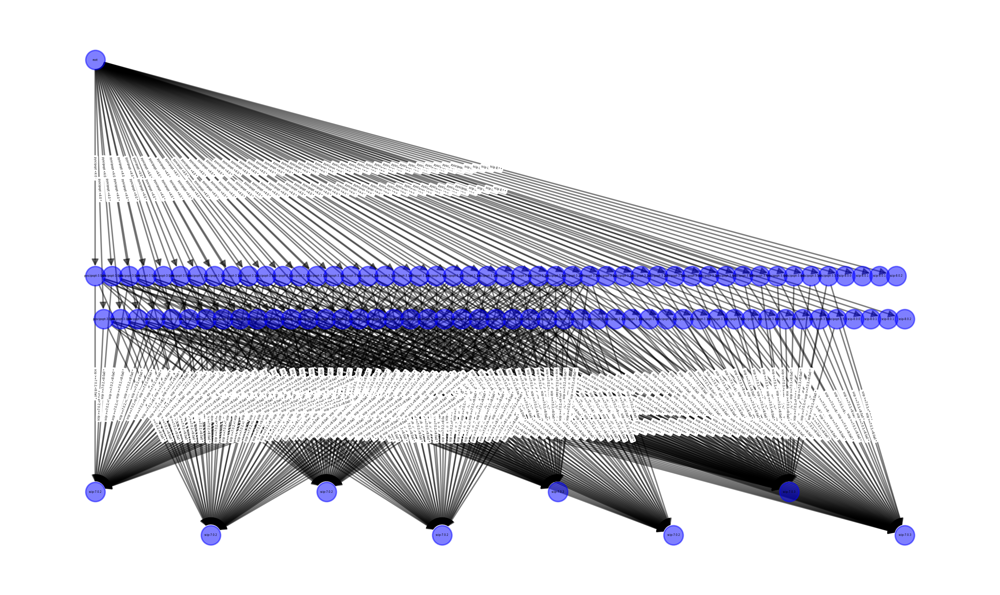

<Figure size 3000x1800 with 0 Axes>

============================================== Compressed graph ==============================================


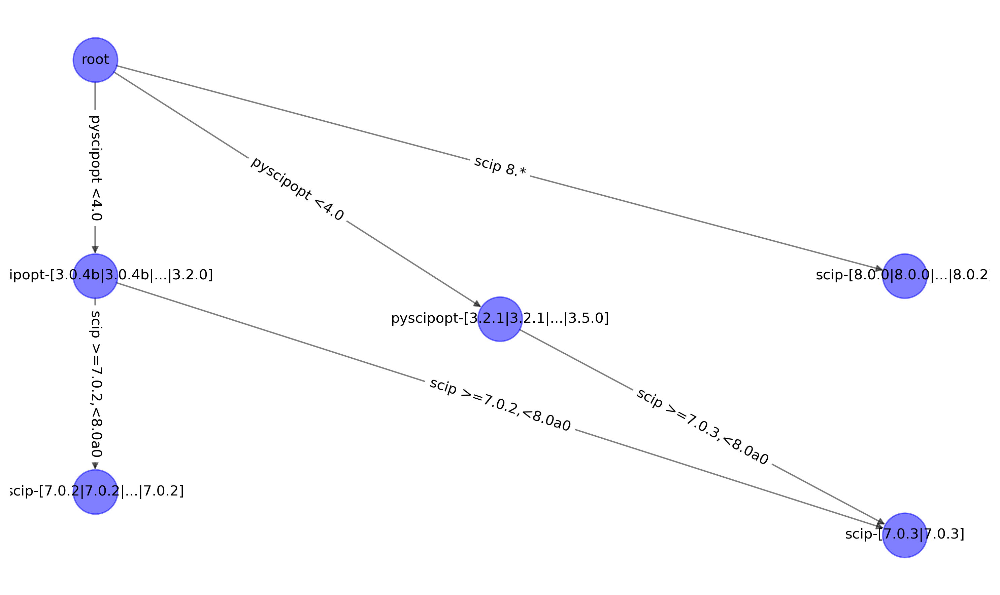

<Figure size 3000x1800 with 0 Axes>

=========================================== Libmamba error message ===========================================
The following packages are incompatible
├─ pyscipopt <4.0 * is installable with the potential options
│  ├─ pyscipopt [3.0.4b|3.0.4b|...|3.2.0] would require
│  │  └─ scip >=7.0.2,<8.0a0 *, which can be installed;
│  └─ pyscipopt [3.2.1|3.2.1|...|3.5.0] would require
│     └─ scip >=7.0.3,<8.0a0 *, which can be installed;
└─ scip 8.* * is uninstallable because it conflicts with any installable versions previously reported.


In [11]:
detail_problem(mer.problems.create_scip)

# JupyterLab OpenSSL

conda-forge/linux-64                                        Using cache
conda-forge/noarch                                          Using cache
=============================================== Original graph ===============================================


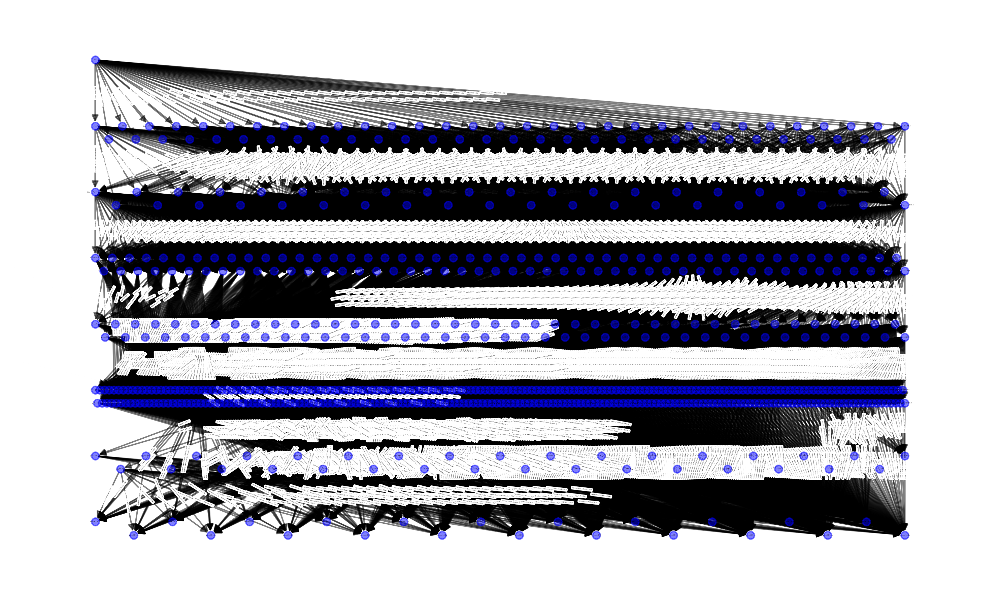

<Figure size 3000x1800 with 0 Axes>

============================================== Compressed graph ==============================================


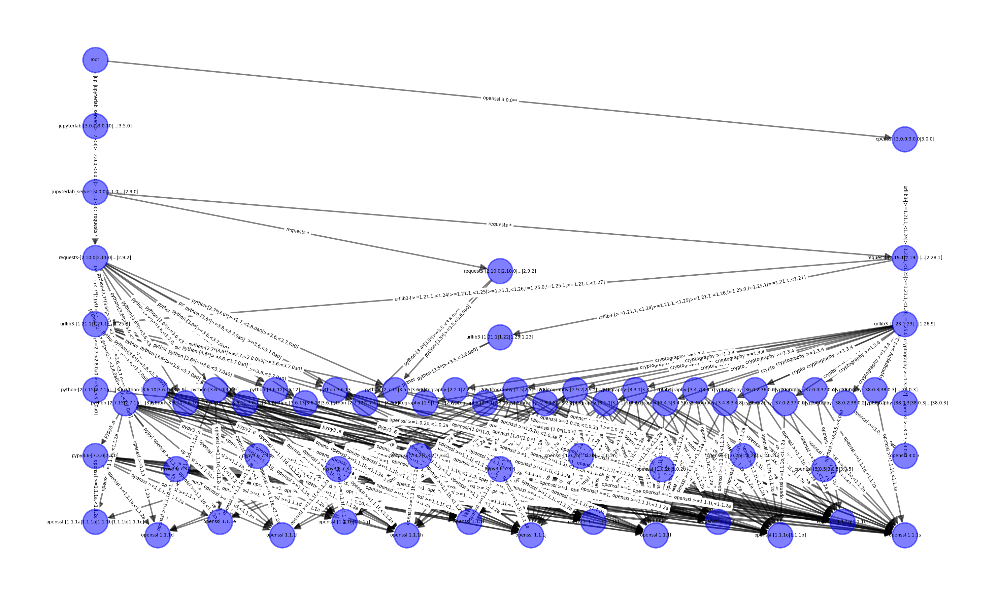

<Figure size 3000x1800 with 0 Axes>

=========================================== Libmamba error message ===========================================
The following packages are incompatible
├─ jupyterlab >3.0 * is installable and it requires
│  └─ jupyterlab_server [>=2,<3|>=2.0.0,<3.0.0|>=2.10,<3|>=2.3,<3] [*|*|*|*], which requires
│     └─ requests * * with the potential options
│        ├─ requests [2.10.0|2.11.0|...|2.9.2] would require
│        │  └─ python [2.7*|3.6*|>=2.7,<2.8.0a0|>=3.6,<3.7.0a0] [*|*|*|*] with the potential options
│        │     ├─ python [2.7.12|2.7.12|...|3.6.5] would require
│        │     │  └─ openssl [1.0*|1.0.*] [*|*], which can be installed;
│        │     ├─ python [2.7.15|2.7.15|...|3.6.7] would require
│        │     │  └─ openssl >=1.0.2p,<1.0.3a *, which can be installed;
│        │     ├─ python [2.7.15|2.7.15|...|3.6.9] would require
│        │     │  ├─ openssl >=1.1.1a,<1.1.2a *, which can be installed;
│        │     │  └─ pypy3 .6 7.3.0.* with the potential options
│        │    

In [12]:
detail_problem(mer.problems.create_jupyterlab)